# Assignment 7
Our goal in this assignment is to apply our logistic regression technique to some new samples:
1.  Apply the technique to the pulsar dataset, but using only two variables.   Plot the cost function and the decision boundary.   Compare the $\theta$ values you obtain with your method with the results that you get using the scipy minimization methods.   **NOTE**: you may need to adjust your learning rate and delta parameters to get convergence.
2. Apply the technique to the MINST dataset, using one digit (say 5) as the positive (y=1) class, and another digit (say 7) as the negative (y=0) class.
3. **Extra**: Try to do a simple version of a multi-class classification problem using MNIST: use 3 digits.   Your primary output should be a confusion matrix.   Hint: you will want to loop over the 3 digits, in each case treating that digit as signal, and the others as background.

# 1: Pulsar dataset

In [1]:
import pandas as pd

#
# Get the feature data
url = "/fs/scratch/PAS1585/HTRU2/HTRU_2a.csv"
dfAll=pd.read_csv(url)
#
# Make sure our dataset is balanced
dfA = dfAll[dfAll['class']==1]
dfB = dfAll[dfAll['class']==0]
dfB_use = dfB.head(len(dfA))
dfCombined = dfB_use
dfCombined = pd.concat([dfCombined, dfA])
dfCombined.head(5)
mid = dfCombined['class']
dfCombined.drop(labels=['class'], axis=1,inplace = True)
dfCombined.insert(0, 'class', mid)
corr = dfCombined.corr()
corr.style.background_gradient().set_precision(3)

,class,Profile_mean,Profile_stdev,Profile_skewness,Profile_kurtosis,DM_mean,DM_stdev,DM_skewness,DM_kurtosis
class,1,-0.773,-0.514,0.736,0.608,0.548,0.722,-0.664,-0.502
Profile_mean,-0.773,1,0.675,-0.941,-0.842,-0.652,-0.676,0.624,0.433
Profile_stdev,-0.514,0.675,1,-0.713,-0.726,-0.275,-0.371,0.363,0.287
Profile_skewness,0.736,-0.941,-0.713,1,0.963,0.661,0.69,-0.638,-0.444
Profile_kurtosis,0.608,-0.842,-0.726,0.963,1,0.595,0.597,-0.555,-0.383
DM_mean,0.548,-0.652,-0.275,0.661,0.595,1,0.793,-0.694,-0.434
DM_stdev,0.722,-0.676,-0.371,0.69,0.597,0.793,1,-0.876,-0.653
DM_skewness,-0.664,0.624,0.363,-0.638,-0.555,-0.694,-0.876,1,0.916
DM_kurtosis,-0.502,0.433,0.287,-0.444,-0.383,-0.434,-0.653,0.916,1


According to the correlation table, 'Profile_skewness' and 'Profile_mean' are the most relatted features to 'class'

# Pull in methods from logistic class
You will need to:
- Pull in code to run the fit
- Pull in code to plot the decision boundary
- Actually run the fit, print out the results and plot the decision boundary

In [2]:
import pandas as pd
import numpy as np
from sklearn import datasets
from sklearn.preprocessing import MinMaxScaler
scl = MinMaxScaler()

In [3]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)
  
enable_plotly_in_cell()

In [4]:
import numpy as np
def sigmoid(z):
    sm = 1.0 / (1.0 + np.exp(z))
    return sm

def get_prob(Theta,Xp):
    hTheta = sigmoid(-np.dot(Xp,Theta))
    return hTheta.item(0)

In [5]:
def calc_cost_logistic(Theta,Xp,yp):
    hTheta = sigmoid(-np.dot(Xp,Theta))
    print("hTheta: ", hTheta)
    cost = np.dot(-yp.T,np.log(hTheta)) - np.dot((1.0 -yp).T,np.log(1.0-hTheta))
    print("cost_:", cost)
#
# Cost above is a 1x1 matrix - pull out the single value and return it
    cost = cost.item(0)
    return cost

In [6]:
def calc_gradient_descent_logistic(Theta,Xp,yp):
    hTheta = sigmoid(-np.dot(Xp,Theta))
    delTheta = np.dot(Xp.transpose(),(hTheta-yp))
    return delTheta

In [7]:
#def fit_data(Xp,yp,learningRate,max_iterations,scale=True,delta=0.001):
def fit_data(Xp,yp,learningRate,max_iterations,delta=0.001):
#
# Get the initial values
    m,features = Xp.shape
#
# Set the starting theta values
    Theta = np.random.randn(features,1)/10000.0
    #Theta = np.zeros((features,1))
    print("Starting theta",Theta.shape)
    costList = []
#
#Calculate our initial cost
    cost = calc_cost_logistic(Theta,Xp,yp)
    print("first cost: ", cost)
    cost_change = delta+0.1
    iterations = 0
#
# In the while loop, "delta" is the precision
    while (iterations<iterations_max) and (cost_change>delta):
        last_cost = cost
#
# Update the theta parameters
        Theta = Theta - learningRate*calc_gradient_descent_logistic(Theta,Xp,yp)
#
# Calculate the cost
        cost = calc_cost_logistic(Theta,Xp,yp)
        cost_change = last_cost - cost
#
# Store the cost
        costList.append(cost)
        iterations += 1
    
    return Theta,iterations,costList

In [8]:
import pandas as pd
import numpy as np
from sklearn import datasets
from sklearn.preprocessing import MinMaxScaler
scl = MinMaxScaler()

# get X and y from pd DataFrame
X = dfCombined[['Profile_skewness', 'DM_mean']].values
y = dfCombined[['class']].values
print(X.shape)
print(y.shape)

# normalize data
XtoFit = scl.fit_transform(X)
y = scl.fit_transform(y)
y.reshape(len(dfCombined), 1)
# add ones column
ones = np.ones((len(dfCombined), 1))
print("the shape of ones:", ones.shape)
XtoFit = np.append(ones, XtoFit, axis = 1)
print("the shape of XtoFit: ", XtoFit.shape)
print("the shape of y:", y.shape)


(3278, 2)
(3278, 1)
the shape of ones: (3278, 1)
the shape of XtoFit:  (3278, 3)
the shape of y: (3278, 1)


/apps/project/ondemand/python/3.6-conda5.2/lib/python3.6/site-packages/sklearn/utils/validation.py:590: DataConversionWarning:

Data with input dtype int64 was converted to float64 by MinMaxScaler.



In [9]:
iterations_max = 10000
learningRate = 0.001
delta = 0.001
Theta,iterations,costList = fit_data(XtoFit,y,learningRate,iterations_max,delta=delta)
#Theta,costList = fit_data_minimize(XToFit,yToFit,learningRate,iterations)
print("fit Theta ",Theta)
print("iterations ",iterations)
print("cost",costList[-1])

countTrue = 0
foundTrue = 0
m,features = XtoFit.shape
#
# Loop over our dataset again, and test each sample
for Xtest,yTest in zip(XtoFit,y):
#
# Make sure the features and label from this sample have the correct shape
  Xtest = Xtest.reshape(1,features)
  yTest = yTest.reshape(1,1)
#
# Get the probability for this sample
  thisProb = get_prob(Theta,Xtest)
#
# Keep track of correct classifications
  if yTest.item(0)==1:
    countTrue += 1
  if thisProb>0.5:
    foundTrue += 1
    
print("Total size ",len(y),"; actual true:",countTrue,"; found true: ",foundTrue)

print("theta ",Theta)
#print("cost ",costList[:-10])

Starting theta (3, 1)
hTheta:  [[0.50002864]
 [0.50002987]
 [0.50002937]
 ...
 [0.50002382]
 [0.50000752]
 [0.49999847]]
cost_: [[2272.15507245]]
first cost:  2272.155072450473
hTheta:  [[0.50697068]
 [0.51160715]
 [0.51089569]
 ...
 [0.52904057]
 [0.58096191]
 [0.54287116]]
cost_: [[2182.10843717]]
hTheta:  [[0.49217666]
 [0.50075095]
 [0.49944095]
 ...
 [0.53320126]
 [0.62818614]
 [0.55925138]]
cost_: [[2105.86391685]]
hTheta:  [[0.4764077 ]
 [0.48868684]
 [0.48681108]
 ...
 [0.53527281]
 [0.66888213]
 [0.57262941]]
cost_: [[2036.97624438]]
hTheta:  [[0.46142145]
 [0.47720967]
 [0.47479439]
 ...
 [0.5372097 ]
 [0.7053288 ]
 [0.58506152]]
cost_: [[1974.57705812]]
hTheta:  [[0.44734615]
 [0.46645394]
 [0.46352434]
 ...
 [0.53919816]
 [0.73787269]
 [0.59679097]]
cost_: [[1917.91765271]]
hTheta:  [[0.43415446]
 [0.45639866]
 [0.45297907]
 ...
 [0.54126067]
 [0.76678038]
 [0.60789353]]
cost_: [[1866.33095963]]
hTheta:  [[0.42179801]
 [0.44700362]
 [0.4431173 ]
 ...
 [0.54339942]
 [0.79235

hTheta:  [[0.10970093]
 [0.22253588]
 [0.19873517]
 ...
 [0.8074028 ]
 [0.99993272]
 [0.93260677]]
cost_: [[850.63836967]]
hTheta:  [[0.10937038]
 [0.2223169 ]
 [0.19847069]
 ...
 [0.80806607]
 [0.99993414]
 [0.9328545 ]]
cost_: [[849.74325457]]
hTheta:  [[0.10904226]
 [0.22209958]
 [0.19820805]
 ...
 [0.80872523]
 [0.99993553]
 [0.93309966]]
cost_: [[848.85484078]]
hTheta:  [[0.10871654]
 [0.2218839 ]
 [0.19794723]
 ...
 [0.8093803 ]
 [0.99993689]
 [0.93334226]]
cost_: [[847.97304503]]
hTheta:  [[0.10839319]
 [0.22166983]
 [0.19768821]
 ...
 [0.81003132]
 [0.9999382 ]
 [0.93358236]]
cost_: [[847.09778548]]
hTheta:  [[0.10807219]
 [0.22145737]
 [0.19743096]
 ...
 [0.81067833]
 [0.99993949]
 [0.93381998]]
cost_: [[846.22898176]]
hTheta:  [[0.1077535 ]
 [0.22124648]
 [0.19717548]
 ...
 [0.81132137]
 [0.99994075]
 [0.93405516]]
cost_: [[845.36655485]]
hTheta:  [[0.10743711]
 [0.22103715]
 [0.19692173]
 ...
 [0.81196047]
 [0.99994197]
 [0.93428794]]
cost_: [[844.5104271]]
hTheta:  [[0.1071

hTheta:  [[0.06932924]
 [0.19622935]
 [0.16531943]
 ...
 [0.89196017]
 [0.99999747]
 [0.95635697]]
cost_: [[741.82122671]]
hTheta:  [[0.06921845]
 [0.19615877]
 [0.16522331]
 ...
 [0.89219441]
 [0.9999975 ]
 [0.95640114]]
cost_: [[741.52283628]]
hTheta:  [[0.06910807]
 [0.19608845]
 [0.16512751]
 ...
 [0.89242775]
 [0.99999753]
 [0.95644501]]
cost_: [[741.22555241]]
hTheta:  [[0.0689981 ]
 [0.19601842]
 [0.16503203]
 ...
 [0.89266017]
 [0.99999756]
 [0.95648858]]
cost_: [[740.92936849]]
hTheta:  [[0.06888854]
 [0.19594865]
 [0.16493687]
 ...
 [0.89289169]
 [0.99999758]
 [0.95653186]]
cost_: [[740.63427801]]
hTheta:  [[0.06877939]
 [0.19587915]
 [0.16484204]
 ...
 [0.89312232]
 [0.99999761]
 [0.95657484]]
cost_: [[740.34027448]]
hTheta:  [[0.06867063]
 [0.19580993]
 [0.16474751]
 ...
 [0.89335205]
 [0.99999764]
 [0.95661752]]
cost_: [[740.04735148]]
hTheta:  [[0.06856228]
 [0.19574096]
 [0.16465331]
 ...
 [0.89358089]
 [0.99999766]
 [0.95665992]]
cost_: [[739.75550264]]
hTheta:  [[0.068

hTheta:  [[0.05214838]
 [0.18544642]
 [0.14990413]
 ...
 [0.92745738]
 [0.99999967]
 [0.96134811]]
cost_: [[695.49492576]]
hTheta:  [[0.05209109]
 [0.18541107]
 [0.14985059]
 ...
 [0.92757173]
 [0.99999967]
 [0.96135758]]
cost_: [[695.3403761]]
hTheta:  [[0.05203394]
 [0.1853758 ]
 [0.14979716]
 ...
 [0.92768575]
 [0.99999967]
 [0.96136696]]
cost_: [[695.18621863]]
hTheta:  [[0.05197693]
 [0.18534063]
 [0.14974385]
 ...
 [0.92779946]
 [0.99999968]
 [0.96137627]]
cost_: [[695.0324518]]
hTheta:  [[0.05192007]
 [0.18530556]
 [0.14969066]
 ...
 [0.92791284]
 [0.99999968]
 [0.9613855 ]]
cost_: [[694.87907409]]
hTheta:  [[0.05186334]
 [0.18527057]
 [0.14963758]
 ...
 [0.9280259 ]
 [0.99999968]
 [0.96139465]]
cost_: [[694.72608399]]
hTheta:  [[0.05180677]
 [0.18523568]
 [0.14958462]
 ...
 [0.92813864]
 [0.99999968]
 [0.96140373]]
cost_: [[694.57347998]]
hTheta:  [[0.05175033]
 [0.18520088]
 [0.14953178]
 ...
 [0.92825106]
 [0.99999969]
 [0.96141273]]
cost_: [[694.42126057]]
hTheta:  [[0.05169

cost_: [[669.34355471]]
hTheta:  [[0.04239494]
 [0.17948268]
 [0.1404867 ]
 ...
 [0.94633203]
 [0.99999992]
 [0.96206902]]
cost_: [[669.24798708]]
hTheta:  [[0.04235934]
 [0.17946108]
 [0.14045101]
 ...
 [0.94639845]
 [0.99999992]
 [0.96206799]]
cost_: [[669.1526089]]
hTheta:  [[0.04232381]
 [0.17943952]
 [0.14041537]
 ...
 [0.94646472]
 [0.99999992]
 [0.96206692]]
cost_: [[669.0574196]]
hTheta:  [[0.04228834]
 [0.179418  ]
 [0.14037979]
 ...
 [0.94653084]
 [0.99999992]
 [0.96206583]]
cost_: [[668.96241864]]
hTheta:  [[0.04225295]
 [0.17939652]
 [0.14034426]
 ...
 [0.94659682]
 [0.99999993]
 [0.96206471]]
cost_: [[668.86760545]]
hTheta:  [[0.04221762]
 [0.17937509]
 [0.1403088 ]
 ...
 [0.94666265]
 [0.99999993]
 [0.96206357]]
cost_: [[668.77297949]]
hTheta:  [[0.04218236]
 [0.1793537 ]
 [0.14027339]
 ...
 [0.94672833]
 [0.99999993]
 [0.96206239]]
cost_: [[668.67854021]]
hTheta:  [[0.04214717]
 [0.17933235]
 [0.14023803]
 ...
 [0.94679387]
 [0.99999993]
 [0.96206119]]
cost_: [[668.58428

cost_: [[652.34031041]]
hTheta:  [[0.03601842]
 [0.17561707]
 [0.13388504]
 ...
 [0.95788128]
 [0.99999998]
 [0.96136755]]
cost_: [[652.27565136]]
hTheta:  [[0.03599396]
 [0.17560221]
 [0.13385879]
 ...
 [0.95792415]
 [0.99999998]
 [0.9613627 ]]
cost_: [[652.21109937]]
hTheta:  [[0.03596953]
 [0.17558737]
 [0.13383256]
 ...
 [0.95796695]
 [0.99999998]
 [0.96135784]]
cost_: [[652.14665418]]
hTheta:  [[0.03594514]
 [0.17557255]
 [0.13380638]
 ...
 [0.95800966]
 [0.99999998]
 [0.96135297]]
cost_: [[652.08231555]]
hTheta:  [[0.03592079]
 [0.17555775]
 [0.13378022]
 ...
 [0.9580523 ]
 [0.99999998]
 [0.96134809]]
cost_: [[652.01808321]]
hTheta:  [[0.03589647]
 [0.17554298]
 [0.1337541 ]
 ...
 [0.95809486]
 [0.99999998]
 [0.9613432 ]]
cost_: [[651.95395692]]
hTheta:  [[0.0358722 ]
 [0.17552823]
 [0.13372801]
 ...
 [0.95813734]
 [0.99999998]
 [0.9613383 ]]
cost_: [[651.88993642]]
hTheta:  [[0.03584796]
 [0.1755135 ]
 [0.13370196]
 ...
 [0.95817975]
 [0.99999998]
 [0.96133339]]
cost_: [[651.826

cost_: [[640.63935104]]
hTheta:  [[0.03154708]
 [0.17288172]
 [0.12893781]
 ...
 [0.96551172]
 [0.99999999]
 [0.96017202]]
cost_: [[640.59282036]]
hTheta:  [[0.03152909]
 [0.1728706 ]
 [0.12891723]
 ...
 [0.96554156]
 [0.99999999]
 [0.9601659 ]]
cost_: [[640.54635684]]
hTheta:  [[0.03151111]
 [0.17285949]
 [0.12889666]
 ...
 [0.96557135]
 [0.99999999]
 [0.96015977]]
cost_: [[640.49996033]]
hTheta:  [[0.03149317]
 [0.17284839]
 [0.12887612]
 ...
 [0.9656011 ]
 [0.99999999]
 [0.96015365]]
cost_: [[640.45363071]]
hTheta:  [[0.03147524]
 [0.17283731]
 [0.12885559]
 ...
 [0.96563079]
 [0.99999999]
 [0.96014752]]
cost_: [[640.40736784]]
hTheta:  [[0.03145734]
 [0.17282624]
 [0.12883509]
 ...
 [0.96566045]
 [0.99999999]
 [0.96014138]]
cost_: [[640.36117158]]
hTheta:  [[0.03143947]
 [0.17281519]
 [0.12881461]
 ...
 [0.96569005]
 [0.99999999]
 [0.96013525]]
cost_: [[640.31504181]]
hTheta:  [[0.03142161]
 [0.17280415]
 [0.12879415]
 ...
 [0.96571961]
 [0.99999999]
 [0.96012911]]
cost_: [[640.268

cost_: [[631.98660505]]
hTheta:  [[0.02815901]
 [0.17075917]
 [0.12494509]
 ...
 [0.97099685]
 [1.        ]
 [0.95882472]]
cost_: [[631.95190234]]
hTheta:  [[0.02814522]
 [0.17075039]
 [0.12492832]
 ...
 [0.9710186 ]
 [1.        ]
 [0.95881843]]
cost_: [[631.91724441]]
hTheta:  [[0.02813145]
 [0.17074162]
 [0.12491156]
 ...
 [0.97104033]
 [1.        ]
 [0.95881214]]
cost_: [[631.88263119]]
hTheta:  [[0.0281177 ]
 [0.17073285]
 [0.12489482]
 ...
 [0.97106202]
 [1.        ]
 [0.95880586]]
cost_: [[631.84806258]]
hTheta:  [[0.02810396]
 [0.1707241 ]
 [0.12487809]
 ...
 [0.97108369]
 [1.        ]
 [0.95879957]]
cost_: [[631.81353853]]
hTheta:  [[0.02809024]
 [0.17071535]
 [0.12486138]
 ...
 [0.97110532]
 [1.        ]
 [0.95879329]]
cost_: [[631.77905894]]
hTheta:  [[0.02807653]
 [0.17070661]
 [0.12484468]
 ...
 [0.97112693]
 [1.        ]
 [0.958787  ]]
cost_: [[631.74462373]]
hTheta:  [[0.02806284]
 [0.17069788]
 [0.124828  ]
 ...
 [0.9711485 ]
 [1.        ]
 [0.95878072]]
cost_: [[631.710

cost_: [[625.81718991]]
hTheta:  [[0.02567523]
 [0.16914954]
 [0.12184261]
 ...
 [0.974838  ]
 [1.        ]
 [0.95758858]]
cost_: [[625.79011697]]
hTheta:  [[0.02566416]
 [0.16914223]
 [0.12182839]
 ...
 [0.97485475]
 [1.        ]
 [0.95758263]]
cost_: [[625.76307604]]
hTheta:  [[0.02565311]
 [0.16913492]
 [0.12181419]
 ...
 [0.97487148]
 [1.        ]
 [0.95757667]]
cost_: [[625.73606707]]
hTheta:  [[0.02564207]
 [0.16912762]
 [0.1218    ]
 ...
 [0.97488819]
 [1.        ]
 [0.95757072]]
cost_: [[625.70909002]]
hTheta:  [[0.02563104]
 [0.16912033]
 [0.12178582]
 ...
 [0.97490488]
 [1.        ]
 [0.95756476]]
cost_: [[625.68214483]]
hTheta:  [[0.02562002]
 [0.16911304]
 [0.12177166]
 ...
 [0.97492155]
 [1.        ]
 [0.95755881]]
cost_: [[625.65523145]]
hTheta:  [[0.02560901]
 [0.16910575]
 [0.1217575 ]
 ...
 [0.9749382 ]
 [1.        ]
 [0.95755287]]
cost_: [[625.62834983]]
hTheta:  [[0.02559802]
 [0.16909848]
 [0.12174335]
 ...
 [0.97495482]
 [1.        ]
 [0.95754692]]
cost_: [[625.601

cost_: [[620.7009108]]
hTheta:  [[0.02355154]
 [0.16771577]
 [0.11904182]
 ...
 [0.97799133]
 [1.        ]
 [0.95637855]]
cost_: [[620.67965963]]
hTheta:  [[0.02354256]
 [0.16770957]
 [0.11902965]
 ...
 [0.97800439]
 [1.        ]
 [0.95637317]]
cost_: [[620.65843168]]
hTheta:  [[0.02353359]
 [0.16770337]
 [0.11901749]
 ...
 [0.97801743]
 [1.        ]
 [0.9563678 ]]
cost_: [[620.63722693]]
hTheta:  [[0.02352464]
 [0.16769717]
 [0.11900534]
 ...
 [0.97803046]
 [1.        ]
 [0.95636243]]
cost_: [[620.61604532]]
hTheta:  [[0.02351569]
 [0.16769098]
 [0.11899319]
 ...
 [0.97804347]
 [1.        ]
 [0.95635706]]
cost_: [[620.59488684]]
hTheta:  [[0.02350674]
 [0.1676848 ]
 [0.11898106]
 ...
 [0.97805647]
 [1.        ]
 [0.9563517 ]]
cost_: [[620.57375145]]
hTheta:  [[0.02349781]
 [0.16767861]
 [0.11896893]
 ...
 [0.97806946]
 [1.        ]
 [0.95634634]]
cost_: [[620.55263912]]
hTheta:  [[0.02348889]
 [0.16767244]
 [0.11895681]
 ...
 [0.97808243]
 [1.        ]
 [0.95634098]]
cost_: [[620.5315

hTheta:  [[0.02181968]
 [0.16649056]
 [0.11663492]
 ...
 [0.98046713]
 [1.        ]
 [0.95530859]]
cost_: [[616.6504972]]
hTheta:  [[0.02181225]
 [0.16648517]
 [0.11662433]
 ...
 [0.98047755]
 [1.        ]
 [0.95530388]]
cost_: [[616.63352742]]
hTheta:  [[0.02180483]
 [0.16647979]
 [0.11661374]
 ...
 [0.98048797]
 [1.        ]
 [0.95529917]]
cost_: [[616.61657497]]
hTheta:  [[0.02179742]
 [0.16647441]
 [0.11660316]
 ...
 [0.98049837]
 [1.        ]
 [0.95529447]]
cost_: [[616.59963981]]
hTheta:  [[0.02179001]
 [0.16646903]
 [0.11659259]
 ...
 [0.98050877]
 [1.        ]
 [0.95528977]]
cost_: [[616.58272194]]
hTheta:  [[0.02178261]
 [0.16646365]
 [0.11658202]
 ...
 [0.98051915]
 [1.        ]
 [0.95528507]]
cost_: [[616.56582131]]
hTheta:  [[0.02177521]
 [0.16645828]
 [0.11657146]
 ...
 [0.98052952]
 [1.        ]
 [0.95528038]]
cost_: [[616.54893792]]
hTheta:  [[0.02176782]
 [0.16645291]
 [0.11656091]
 ...
 [0.98053988]
 [1.        ]
 [0.95527569]]
cost_: [[616.53207174]]
hTheta:  [[0.0217

hTheta:  [[0.02034401]
 [0.16539347]
 [0.11448037]
 ...
 [0.98250448]
 [1.        ]
 [0.95436108]]
cost_: [[613.33884542]]
hTheta:  [[0.02033779]
 [0.16538873]
 [0.11447107]
 ...
 [0.98251292]
 [1.        ]
 [0.95435706]]
cost_: [[613.32515758]]
hTheta:  [[0.02033158]
 [0.16538398]
 [0.11446177]
 ...
 [0.98252135]
 [1.        ]
 [0.95435304]]
cost_: [[613.31148289]]
hTheta:  [[0.02032537]
 [0.16537924]
 [0.11445247]
 ...
 [0.98252977]
 [1.        ]
 [0.95434902]]
cost_: [[613.29782133]]
hTheta:  [[0.02031917]
 [0.1653745 ]
 [0.11444318]
 ...
 [0.98253819]
 [1.        ]
 [0.954345  ]]
cost_: [[613.2841729]]
hTheta:  [[0.02031297]
 [0.16536977]
 [0.1144339 ]
 ...
 [0.9825466 ]
 [1.        ]
 [0.95434099]]
cost_: [[613.27053756]]
hTheta:  [[0.02030677]
 [0.16536503]
 [0.11442462]
 ...
 [0.982555  ]
 [1.        ]
 [0.95433698]]
cost_: [[613.25691532]]
hTheta:  [[0.02030058]
 [0.1653603 ]
 [0.11441535]
 ...
 [0.98256339]
 [1.        ]
 [0.95433297]]
cost_: [[613.24330614]]
hTheta:  [[0.0202

cost_: [[610.65186716]]
hTheta:  [[0.01909493]
 [0.1644163 ]
 [0.11256978]
 ...
 [0.98417402]
 [1.        ]
 [0.9535544 ]]
cost_: [[610.6406944]]
hTheta:  [[0.01908966]
 [0.16441206]
 [0.11256153]
 ...
 [0.98418096]
 [1.        ]
 [0.95355102]]
cost_: [[610.6295318]]
hTheta:  [[0.01908439]
 [0.16440783]
 [0.11255328]
 ...
 [0.98418789]
 [1.        ]
 [0.95354764]]
cost_: [[610.61837938]]
hTheta:  [[0.01907912]
 [0.1644036 ]
 [0.11254504]
 ...
 [0.98419482]
 [1.        ]
 [0.95354426]]
cost_: [[610.60723711]]
hTheta:  [[0.01907386]
 [0.16439937]
 [0.1125368 ]
 ...
 [0.98420173]
 [1.        ]
 [0.95354089]]
cost_: [[610.59610497]]
hTheta:  [[0.0190686 ]
 [0.16439515]
 [0.11252856]
 ...
 [0.98420865]
 [1.        ]
 [0.95353752]]
cost_: [[610.58498297]]
hTheta:  [[0.01906335]
 [0.16439092]
 [0.11252033]
 ...
 [0.98421556]
 [1.        ]
 [0.95353415]]
cost_: [[610.57387109]]
hTheta:  [[0.0190581 ]
 [0.1643867 ]
 [0.11251211]
 ...
 [0.98422246]
 [1.        ]
 [0.95353078]]
cost_: [[610.56276

cost_: [[608.43853342]]
hTheta:  [[0.01802984]
 [0.16354005]
 [0.11086856]
 ...
 [0.98555568]
 [1.        ]
 [0.95288068]]
cost_: [[608.42933015]]
hTheta:  [[0.01802531]
 [0.16353624]
 [0.11086118]
 ...
 [0.98556146]
 [1.        ]
 [0.95287787]]
cost_: [[608.42013488]]
hTheta:  [[0.01802079]
 [0.16353242]
 [0.11085381]
 ...
 [0.98556723]
 [1.        ]
 [0.95287506]]
cost_: [[608.41094759]]
hTheta:  [[0.01801628]
 [0.16352861]
 [0.11084644]
 ...
 [0.98557301]
 [1.        ]
 [0.95287226]]
cost_: [[608.40176827]]
hTheta:  [[0.01801176]
 [0.1635248 ]
 [0.11083908]
 ...
 [0.98557877]
 [1.        ]
 [0.95286946]]
cost_: [[608.39259693]]
hTheta:  [[0.01800726]
 [0.16352099]
 [0.11083171]
 ...
 [0.98558454]
 [1.        ]
 [0.95286666]]
cost_: [[608.38343354]]
hTheta:  [[0.01800275]
 [0.16351719]
 [0.11082435]
 ...
 [0.98559029]
 [1.        ]
 [0.95286387]]
cost_: [[608.3742781]]
hTheta:  [[0.01799824]
 [0.16351338]
 [0.110817  ]
 ...
 [0.98559605]
 [1.        ]
 [0.95286107]]
cost_: [[608.3651

cost_: [[606.59233793]]
hTheta:  [[0.01710428]
 [0.16274047]
 [0.10932948]
 ...
 [0.98672339]
 [1.        ]
 [0.9523197 ]]
cost_: [[606.58470458]]
hTheta:  [[0.01710037]
 [0.16273701]
 [0.10932285]
 ...
 [0.98672826]
 [1.        ]
 [0.9523174 ]]
cost_: [[606.57707758]]
hTheta:  [[0.01709646]
 [0.16273355]
 [0.10931622]
 ...
 [0.98673312]
 [1.        ]
 [0.9523151 ]]
cost_: [[606.56945693]]
hTheta:  [[0.01709255]
 [0.16273009]
 [0.10930959]
 ...
 [0.98673798]
 [1.        ]
 [0.9523128 ]]
cost_: [[606.56184261]]
hTheta:  [[0.01708865]
 [0.16272663]
 [0.10930297]
 ...
 [0.98674283]
 [1.        ]
 [0.9523105 ]]
cost_: [[606.55423462]]
hTheta:  [[0.01708475]
 [0.16272318]
 [0.10929635]
 ...
 [0.98674769]
 [1.        ]
 [0.95230821]]
cost_: [[606.54663296]]
hTheta:  [[0.01708085]
 [0.16271972]
 [0.10928974]
 ...
 [0.98675253]
 [1.        ]
 [0.95230592]]
cost_: [[606.53903761]]
hTheta:  [[0.01707696]
 [0.16271627]
 [0.10928312]
 ...
 [0.98675738]
 [1.        ]
 [0.95230363]]
cost_: [[606.531

hTheta:  [[0.01631427]
 [0.16202554]
 [0.10796611]
 ...
 [0.98769476]
 [1.        ]
 [0.95186923]]
cost_: [[605.0745634]]
hTheta:  [[0.01631085]
 [0.16202238]
 [0.1079601 ]
 ...
 [0.98769891]
 [1.        ]
 [0.95186735]]
cost_: [[605.06816931]]
hTheta:  [[0.01630744]
 [0.16201921]
 [0.1079541 ]
 ...
 [0.98770305]
 [1.        ]
 [0.95186548]]
cost_: [[605.06178034]]
hTheta:  [[0.01630402]
 [0.16201605]
 [0.1079481 ]
 ...
 [0.9877072 ]
 [1.        ]
 [0.9518636 ]]
cost_: [[605.05539648]]
hTheta:  [[0.01630061]
 [0.16201289]
 [0.1079421 ]
 ...
 [0.98771134]
 [1.        ]
 [0.95186173]]
cost_: [[605.04901774]]
hTheta:  [[0.0162972 ]
 [0.16200973]
 [0.10793611]
 ...
 [0.98771548]
 [1.        ]
 [0.95185986]]
cost_: [[605.0426441]]
hTheta:  [[0.01629379]
 [0.16200658]
 [0.10793012]
 ...
 [0.98771961]
 [1.        ]
 [0.95185799]]
cost_: [[605.03627556]]
hTheta:  [[0.01629039]
 [0.16200342]
 [0.10792413]
 ...
 [0.98772375]
 [1.        ]
 [0.95185612]]
cost_: [[605.02991211]]
hTheta:  [[0.01628

cost_: [[603.89148946]]
hTheta:  [[0.01566666]
 [0.16141427]
 [0.10681101]
 ...
 [0.98847292]
 [1.        ]
 [0.9515262 ]]
cost_: [[603.88602801]]
hTheta:  [[0.01566363]
 [0.16141135]
 [0.10680552]
 ...
 [0.98847653]
 [1.        ]
 [0.95152466]]
cost_: [[603.88057081]]
hTheta:  [[0.01566059]
 [0.16140843]
 [0.10680002]
 ...
 [0.98848013]
 [1.        ]
 [0.95152312]]
cost_: [[603.87511784]]
hTheta:  [[0.01565756]
 [0.16140551]
 [0.10679453]
 ...
 [0.98848373]
 [1.        ]
 [0.95152158]]
cost_: [[603.86966909]]
hTheta:  [[0.01565453]
 [0.16140259]
 [0.10678904]
 ...
 [0.98848733]
 [1.        ]
 [0.95152004]]
cost_: [[603.86422457]]
hTheta:  [[0.0156515 ]
 [0.16139967]
 [0.10678355]
 ...
 [0.98849093]
 [1.        ]
 [0.9515185 ]]
cost_: [[603.85878427]]
hTheta:  [[0.01564848]
 [0.16139675]
 [0.10677807]
 ...
 [0.98849453]
 [1.        ]
 [0.95151697]]
cost_: [[603.85334818]]
hTheta:  [[0.01564545]
 [0.16139384]
 [0.10677258]
 ...
 [0.98849812]
 [1.        ]
 [0.95151544]]
cost_: [[603.847

cost_: [[602.86923649]]
hTheta:  [[0.0150874 ]
 [0.16084614]
 [0.1057468 ]
 ...
 [0.98915462]
 [1.        ]
 [0.9512442 ]]
cost_: [[602.86455654]]
hTheta:  [[0.0150847 ]
 [0.16084344]
 [0.10574176]
 ...
 [0.98915778]
 [1.        ]
 [0.95124294]]
cost_: [[602.85988011]]
hTheta:  [[0.01508199]
 [0.16084073]
 [0.10573671]
 ...
 [0.98916093]
 [1.        ]
 [0.95124169]]
cost_: [[602.8552072]]
hTheta:  [[0.01507928]
 [0.16083803]
 [0.10573167]
 ...
 [0.98916408]
 [1.        ]
 [0.95124043]]
cost_: [[602.85053782]]
hTheta:  [[0.01507658]
 [0.16083532]
 [0.10572663]
 ...
 [0.98916723]
 [1.        ]
 [0.95123918]]
cost_: [[602.84587194]]
hTheta:  [[0.01507388]
 [0.16083262]
 [0.10572159]
 ...
 [0.98917037]
 [1.        ]
 [0.95123793]]
cost_: [[602.84120958]]
hTheta:  [[0.01507118]
 [0.16082992]
 [0.10571655]
 ...
 [0.98917352]
 [1.        ]
 [0.95123668]]
cost_: [[602.83655073]]
hTheta:  [[0.01506848]
 [0.16082722]
 [0.10571152]
 ...
 [0.98917666]
 [1.        ]
 [0.95123543]]
cost_: [[602.8318

hTheta:  [[0.01457663]
 [0.16032686]
 [0.10478229]
 ...
 [0.98974414]
 [1.        ]
 [0.95101841]]
cost_: [[601.99945929]]
hTheta:  [[0.0145742 ]
 [0.16032435]
 [0.10477764]
 ...
 [0.98974692]
 [1.        ]
 [0.95101739]]
cost_: [[601.9954258]]
hTheta:  [[0.01457177]
 [0.16032183]
 [0.10477299]
 ...
 [0.9897497 ]
 [1.        ]
 [0.95101637]]
cost_: [[601.99139528]]
hTheta:  [[0.01456934]
 [0.16031932]
 [0.10476834]
 ...
 [0.98975247]
 [1.        ]
 [0.95101536]]
cost_: [[601.9873677]]
hTheta:  [[0.01456691]
 [0.16031681]
 [0.10476369]
 ...
 [0.98975525]
 [1.        ]
 [0.95101434]]
cost_: [[601.98334308]]
hTheta:  [[0.01456449]
 [0.1603143 ]
 [0.10475905]
 ...
 [0.98975802]
 [1.        ]
 [0.95101333]]
cost_: [[601.97932141]]
hTheta:  [[0.01456206]
 [0.16031179]
 [0.10475441]
 ...
 [0.98976079]
 [1.        ]
 [0.95101232]]
cost_: [[601.97530269]]
hTheta:  [[0.01455964]
 [0.16030928]
 [0.10474976]
 ...
 [0.98976356]
 [1.        ]
 [0.9510113 ]]
cost_: [[601.97128691]]
hTheta:  [[0.01455

cost_: [[601.24842974]]
hTheta:  [[0.01411263]
 [0.15983899]
 [0.10388343]
 ...
 [0.99026998]
 [1.        ]
 [0.95083447]]
cost_: [[601.24494028]]
hTheta:  [[0.01411044]
 [0.15983665]
 [0.10387913]
 ...
 [0.99027244]
 [1.        ]
 [0.95083365]]
cost_: [[601.24145332]]
hTheta:  [[0.01410825]
 [0.15983431]
 [0.10387484]
 ...
 [0.9902749 ]
 [1.        ]
 [0.95083284]]
cost_: [[601.23796885]]
hTheta:  [[0.01410606]
 [0.15983197]
 [0.10387055]
 ...
 [0.99027735]
 [1.        ]
 [0.95083202]]
cost_: [[601.23448688]]
hTheta:  [[0.01410387]
 [0.15982963]
 [0.10386625]
 ...
 [0.99027981]
 [1.        ]
 [0.95083121]]
cost_: [[601.23100739]]
hTheta:  [[0.01410169]
 [0.15982729]
 [0.10386197]
 ...
 [0.99028226]
 [1.        ]
 [0.9508304 ]]
cost_: [[601.22753039]]
hTheta:  [[0.0140995 ]
 [0.15982495]
 [0.10385768]
 ...
 [0.99028472]
 [1.        ]
 [0.95082958]]
cost_: [[601.22405588]]
hTheta:  [[0.01409732]
 [0.15982262]
 [0.10385339]
 ...
 [0.99028717]
 [1.        ]
 [0.95082877]]
cost_: [[601.220

cost_: [[600.61278432]]
hTheta:  [[0.01370572]
 [0.15939756]
 [0.10307633]
 ...
 [0.99072331]
 [1.        ]
 [0.95069161]]
cost_: [[600.60974464]]
hTheta:  [[0.01370373]
 [0.15939537]
 [0.10307234]
 ...
 [0.9907255 ]
 [1.        ]
 [0.95069096]]
cost_: [[600.60670708]]
hTheta:  [[0.01370175]
 [0.15939319]
 [0.10306836]
 ...
 [0.99072769]
 [1.        ]
 [0.95069031]]
cost_: [[600.60367165]]
hTheta:  [[0.01369976]
 [0.159391  ]
 [0.10306438]
 ...
 [0.99072989]
 [1.        ]
 [0.95068966]]
cost_: [[600.60063835]]
hTheta:  [[0.01369778]
 [0.15938881]
 [0.1030604 ]
 ...
 [0.99073208]
 [1.        ]
 [0.95068901]]
cost_: [[600.59760716]]
hTheta:  [[0.0136958 ]
 [0.15938663]
 [0.10305642]
 ...
 [0.99073427]
 [1.        ]
 [0.95068836]]
cost_: [[600.5945781]]
hTheta:  [[0.01369382]
 [0.15938444]
 [0.10305244]
 ...
 [0.99073646]
 [1.        ]
 [0.95068771]]
cost_: [[600.59155115]]
hTheta:  [[0.01369183]
 [0.15938226]
 [0.10304846]
 ...
 [0.99073864]
 [1.        ]
 [0.95068706]]
cost_: [[600.5885

cost_: [[600.05827174]]
hTheta:  [[0.01333603]
 [0.15898475]
 [0.10232691]
 ...
 [0.99112869]
 [1.        ]
 [0.95057815]]
cost_: [[600.05561612]]
hTheta:  [[0.01333422]
 [0.1589827 ]
 [0.10232321]
 ...
 [0.99113066]
 [1.        ]
 [0.95057763]]
cost_: [[600.05296232]]
hTheta:  [[0.01333242]
 [0.15898065]
 [0.1023195 ]
 ...
 [0.99113262]
 [1.        ]
 [0.95057712]]
cost_: [[600.05031034]]
hTheta:  [[0.01333061]
 [0.15897861]
 [0.1023158 ]
 ...
 [0.99113459]
 [1.        ]
 [0.95057661]]
cost_: [[600.04766018]]
hTheta:  [[0.0133288 ]
 [0.15897656]
 [0.1023121 ]
 ...
 [0.99113655]
 [1.        ]
 [0.95057609]]
cost_: [[600.04501184]]
hTheta:  [[0.013327  ]
 [0.15897452]
 [0.1023084 ]
 ...
 [0.99113852]
 [1.        ]
 [0.95057558]]
cost_: [[600.0423653]]
hTheta:  [[0.0133252 ]
 [0.15897247]
 [0.10230471]
 ...
 [0.99114048]
 [1.        ]
 [0.95057507]]
cost_: [[600.03972059]]
hTheta:  [[0.01332339]
 [0.15897043]
 [0.10230101]
 ...
 [0.99114244]
 [1.        ]
 [0.95057456]]
cost_: [[600.0370

cost_: [[599.56621243]]
hTheta:  [[0.01299413]
 [0.1585924 ]
 [0.10161945]
 ...
 [0.99149799]
 [1.        ]
 [0.95048811]]
cost_: [[599.56389087]]
hTheta:  [[0.01299248]
 [0.15859049]
 [0.10161601]
 ...
 [0.99149975]
 [1.        ]
 [0.95048771]]
cost_: [[599.56157088]]
hTheta:  [[0.01299084]
 [0.15858857]
 [0.10161257]
 ...
 [0.99150152]
 [1.        ]
 [0.95048731]]
cost_: [[599.55925245]]
hTheta:  [[0.01298919]
 [0.15858665]
 [0.10160912]
 ...
 [0.99150329]
 [1.        ]
 [0.95048692]]
cost_: [[599.55693557]]
hTheta:  [[0.01298754]
 [0.15858474]
 [0.10160568]
 ...
 [0.99150505]
 [1.        ]
 [0.95048652]]
cost_: [[599.55462026]]
hTheta:  [[0.0129859 ]
 [0.15858282]
 [0.10160224]
 ...
 [0.99150681]
 [1.        ]
 [0.95048613]]
cost_: [[599.55230649]]
hTheta:  [[0.01298426]
 [0.15858091]
 [0.1015988 ]
 ...
 [0.99150857]
 [1.        ]
 [0.95048573]]
cost_: [[599.54999429]]
hTheta:  [[0.01298261]
 [0.158579  ]
 [0.10159537]
 ...
 [0.99151034]
 [1.        ]
 [0.95048534]]
cost_: [[599.547

cost_: [[599.1416345]]
hTheta:  [[0.01268655]
 [0.15823027]
 [0.10097063]
 ...
 [0.99182551]
 [1.        ]
 [0.95042015]]
cost_: [[599.1395959]]
hTheta:  [[0.01268504]
 [0.15822847]
 [0.10096741]
 ...
 [0.99182711]
 [1.        ]
 [0.95041985]]
cost_: [[599.13755864]]
hTheta:  [[0.01268353]
 [0.15822667]
 [0.1009642 ]
 ...
 [0.9918287 ]
 [1.        ]
 [0.95041954]]
cost_: [[599.13552273]]
hTheta:  [[0.01268202]
 [0.15822488]
 [0.10096099]
 ...
 [0.9918303 ]
 [1.        ]
 [0.95041924]]
cost_: [[599.13348816]]
hTheta:  [[0.01268052]
 [0.15822308]
 [0.10095778]
 ...
 [0.99183189]
 [1.        ]
 [0.95041894]]
cost_: [[599.13145493]]
hTheta:  [[0.01267901]
 [0.15822128]
 [0.10095458]
 ...
 [0.99183348]
 [1.        ]
 [0.95041864]]
cost_: [[599.12942305]]
hTheta:  [[0.01267751]
 [0.15821949]
 [0.10095137]
 ...
 [0.99183507]
 [1.        ]
 [0.95041834]]
cost_: [[599.1273925]]
hTheta:  [[0.012676  ]
 [0.15821769]
 [0.10094817]
 ...
 [0.99183666]
 [1.        ]
 [0.95041804]]
cost_: [[599.125363

cost_: [[598.73450722]]
hTheta:  [[0.01237842]
 [0.15785833]
 [0.10030837]
 ...
 [0.99214906]
 [1.        ]
 [0.95036517]]
cost_: [[598.73273512]]
hTheta:  [[0.01237705]
 [0.15785665]
 [0.10030539]
 ...
 [0.99215049]
 [1.        ]
 [0.95036496]]
cost_: [[598.73096416]]
hTheta:  [[0.01237567]
 [0.15785498]
 [0.10030241]
 ...
 [0.99215192]
 [1.        ]
 [0.95036475]]
cost_: [[598.72919436]]
hTheta:  [[0.0123743 ]
 [0.1578533 ]
 [0.10029943]
 ...
 [0.99215335]
 [1.        ]
 [0.95036453]]
cost_: [[598.72742571]]
hTheta:  [[0.01237293]
 [0.15785162]
 [0.10029645]
 ...
 [0.99215478]
 [1.        ]
 [0.95036432]]
cost_: [[598.7256582]]
hTheta:  [[0.01237156]
 [0.15784994]
 [0.10029348]
 ...
 [0.99215621]
 [1.        ]
 [0.95036411]]
cost_: [[598.72389184]]
hTheta:  [[0.01237019]
 [0.15784827]
 [0.1002905 ]
 ...
 [0.99215764]
 [1.        ]
 [0.95036389]]
cost_: [[598.72212662]]
hTheta:  [[0.01236882]
 [0.15784659]
 [0.10028753]
 ...
 [0.99215906]
 [1.        ]
 [0.95036368]]
cost_: [[598.7203

hTheta:  [[0.01209756]
 [0.15751093]
 [0.09969354]
 ...
 [0.99243992]
 [1.        ]
 [0.95032709]]
cost_: [[598.37863612]]
hTheta:  [[0.01209631]
 [0.15750936]
 [0.09969077]
 ...
 [0.9924412 ]
 [1.        ]
 [0.95032695]]
cost_: [[598.37709293]]
hTheta:  [[0.01209506]
 [0.15750779]
 [0.099688  ]
 ...
 [0.99244249]
 [1.        ]
 [0.95032681]]
cost_: [[598.37555074]]
hTheta:  [[0.0120938 ]
 [0.15750622]
 [0.09968524]
 ...
 [0.99244378]
 [1.        ]
 [0.95032666]]
cost_: [[598.37400952]]
hTheta:  [[0.01209255]
 [0.15750465]
 [0.09968247]
 ...
 [0.99244507]
 [1.        ]
 [0.95032652]]
cost_: [[598.37246929]]
hTheta:  [[0.0120913 ]
 [0.15750309]
 [0.09967971]
 ...
 [0.99244636]
 [1.        ]
 [0.95032638]]
cost_: [[598.37093005]]
hTheta:  [[0.01209005]
 [0.15750152]
 [0.09967694]
 ...
 [0.99244764]
 [1.        ]
 [0.95032624]]
cost_: [[598.36939178]]
hTheta:  [[0.0120888 ]
 [0.15749995]
 [0.09967418]
 ...
 [0.99244893]
 [1.        ]
 [0.9503261 ]]
cost_: [[598.36785449]]
hTheta:  [[0.012

cost_: [[598.06974325]]
hTheta:  [[0.01183973]
 [0.15718462]
 [0.09911933]
 ...
 [0.99270347]
 [1.        ]
 [0.95030271]]
cost_: [[598.06839558]]
hTheta:  [[0.01183858]
 [0.15718315]
 [0.09911676]
 ...
 [0.99270463]
 [1.        ]
 [0.95030262]]
cost_: [[598.06704875]]
hTheta:  [[0.01183744]
 [0.15718168]
 [0.09911418]
 ...
 [0.9927058 ]
 [1.        ]
 [0.95030254]]
cost_: [[598.06570277]]
hTheta:  [[0.01183629]
 [0.15718022]
 [0.09911161]
 ...
 [0.99270696]
 [1.        ]
 [0.95030245]]
cost_: [[598.06435763]]
hTheta:  [[0.01183515]
 [0.15717875]
 [0.09910904]
 ...
 [0.99270812]
 [1.        ]
 [0.95030237]]
cost_: [[598.06301334]]
hTheta:  [[0.011834  ]
 [0.15717729]
 [0.09910646]
 ...
 [0.99270929]
 [1.        ]
 [0.95030229]]
cost_: [[598.06166989]]
hTheta:  [[0.01183286]
 [0.15717582]
 [0.09910389]
 ...
 [0.99271045]
 [1.        ]
 [0.9503022 ]]
cost_: [[598.06032729]]
hTheta:  [[0.01183171]
 [0.15717436]
 [0.09910132]
 ...
 [0.99271161]
 [1.        ]
 [0.95030212]]
cost_: [[598.058

hTheta:  [[0.0116057 ]
 [0.15688205]
 [0.09858971]
 ...
 [0.99293978]
 [1.        ]
 [0.9502897 ]]
cost_: [[597.7997155]]
hTheta:  [[0.01160465]
 [0.15688067]
 [0.09858731]
 ...
 [0.99294083]
 [1.        ]
 [0.95028966]]
cost_: [[597.79853619]]
hTheta:  [[0.0116036 ]
 [0.1568793 ]
 [0.09858491]
 ...
 [0.99294189]
 [1.        ]
 [0.95028963]]
cost_: [[597.79735761]]
hTheta:  [[0.01160255]
 [0.15687793]
 [0.09858252]
 ...
 [0.99294294]
 [1.        ]
 [0.95028959]]
cost_: [[597.79617975]]
hTheta:  [[0.0116015 ]
 [0.15687655]
 [0.09858012]
 ...
 [0.992944  ]
 [1.        ]
 [0.95028955]]
cost_: [[597.79500263]]
hTheta:  [[0.01160045]
 [0.15687518]
 [0.09857772]
 ...
 [0.99294505]
 [1.        ]
 [0.95028951]]
cost_: [[597.79382623]]
hTheta:  [[0.0115994 ]
 [0.15687381]
 [0.09857533]
 ...
 [0.99294611]
 [1.        ]
 [0.95028948]]
cost_: [[597.79265057]]
hTheta:  [[0.01159835]
 [0.15687244]
 [0.09857293]
 ...
 [0.99294716]
 [1.        ]
 [0.95028944]]
cost_: [[597.79147563]]
hTheta:  [[0.0115

hTheta:  [[0.01138878]
 [0.15659594]
 [0.09809139]
 ...
 [0.9931563 ]
 [1.        ]
 [0.95028569]]
cost_: [[597.56217185]]
hTheta:  [[0.01138781]
 [0.15659465]
 [0.09808915]
 ...
 [0.99315726]
 [1.        ]
 [0.95028569]]
cost_: [[597.56113859]]
hTheta:  [[0.01138685]
 [0.15659337]
 [0.09808691]
 ...
 [0.99315822]
 [1.        ]
 [0.95028569]]
cost_: [[597.56010595]]
hTheta:  [[0.01138588]
 [0.15659208]
 [0.09808468]
 ...
 [0.99315917]
 [1.        ]
 [0.95028569]]
cost_: [[597.55907395]]
hTheta:  [[0.01138492]
 [0.15659079]
 [0.09808244]
 ...
 [0.99316013]
 [1.        ]
 [0.95028569]]
cost_: [[597.55804258]]
hTheta:  [[0.01138395]
 [0.15658951]
 [0.09808021]
 ...
 [0.99316109]
 [1.        ]
 [0.95028569]]
cost_: [[597.55701184]]
hTheta:  [[0.01138299]
 [0.15658822]
 [0.09807797]
 ...
 [0.99316205]
 [1.        ]
 [0.95028569]]
cost_: [[597.55598173]]
hTheta:  [[0.01138202]
 [0.15658694]
 [0.09807574]
 ...
 [0.99316301]
 [1.        ]
 [0.95028569]]
cost_: [[597.55495224]]
hTheta:  [[0.011

In [10]:
# plot decision boundary
import matplotlib.pyplot as plt 

def plot_reg(X, y, beta): 
  y = y.reshape(len(y))
  x_0 = X[np.where(y < 0.5)] 
  x_1 = X[np.where(y > 0.5)] 
  print("x_0",x_0.shape,x_1.shape)
  x1_max = np.amax(x_1)
  x1_min = np.amin(x_1)
  print("x1 max,min",x1_max,x1_min)
	
	# plotting points with diff color for diff label 
  plt.scatter([x_0[:, 1]], [x_0[:, 2]], c='b', label='y = 0') 
  plt.scatter([x_1[:, 1]], [x_1[:, 2]], c='r', label='y = 1') 
	
	# plotting decision boundary 
  x1 = np.arange(x1_min, x1_max, 0.1) 
  #x1 = np.arange(0, 1, 0.1) 
  x2 = -(beta[0,0] + beta[1,0]*x1)/beta[2,0] 
  # uncvomment these if you have 3 features
  #x3 = np.arange(0, 1, 0.1) 
  #x2 = -(beta[0,0] + beta[1,0]*x1 + beta[3,0]*x3)/beta[2,0] 
  print("x1",x1.shape,x2.shape)
  plt.plot(x1, x2, c='k', label='reg line') 

  plt.xlabel('x1') 
  plt.ylabel('x2') 
  plt.legend() 
  plt.show() 

In [11]:
def plot_reg_scale(X, y, beta, scl): 
  Xt = scl.inverse_transform(X[:,1:])
  y = y.reshape(len(y))
  x_0 = Xt[np.where(y < 0.5)] 
  x_1 = Xt[np.where(y > 0.5)] 
#
# Inverse transform the points
#  x_0 = scl.inverse_transform(x_0[:,1:])
#  x_1 = scl.inverse_transform(x_1[:,1:])
	
	# plotting points with diff color for diff label 

  plt.scatter([x_0[:, 0]], [x_0[:, 1]], c='b', label='y = 0') 
  plt.scatter([x_1[:, 0]], [x_1[:, 1]], c='r', label='y = 1') 
	
	# plotting decision boundary 
  x1 = np.linspace(0.0,1.0, 10) 
  x2 = -(beta[0,0] + beta[1,0]*x1)/beta[2,0] 
  #
  # Uncomment if you have 3 features
  #x3 = np.linspace(0.0,1.0, 10) 
  #x2 = -(beta[0,0] + beta[1,0]*x1 + beta[3,0]*x3)/beta[2,0] 
  print("x1",x1.shape,x2.shape)
  xline = np.append(x1.reshape(len(x1),1),x2.reshape(len(x2),1),axis=1)
  # Uncomment if you have 3 features
  #xline = np.append(xline,x2.reshape(len(x3),1),axis=1)
  xline = scl.inverse_transform(xline)

  plt.plot(xline[:,0], xline[:,1], c='k', label='reg line') 

  plt.xlabel('x1') 
  plt.ylabel('x2') 
  plt.legend() 
  plt.show() 

(3278, 3)
x_0 (1639, 3) (1639, 3)
x1 max,min 1.0 0.0009322720191611766
x1 (10,) (10,)


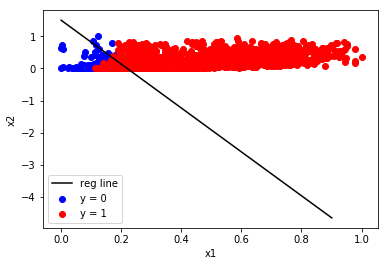

x1 (10,) (10,)


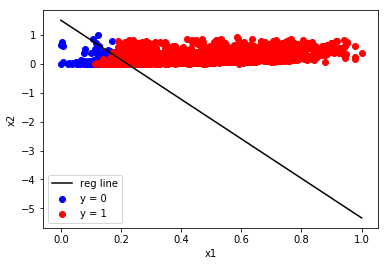

In [12]:
print(XtoFit.shape)
plot_reg(XtoFit, y, Theta)

plot_reg_scale(XtoFit, y, Theta,scl)

In [13]:
# using scipy.optimize.minimize minimaziation technique
def calc_gradient_descent_logistic_new(Theta,Xp,yp):
  Theta = Theta.reshape(len(Theta),1)
  hTheta = sigmoid(-np.dot(Xp,Theta))
  delTheta = np.dot(Xp.transpose(),(hTheta-yp))
  #
  # scipy expects a returned result with dimensions (len(Theta),) instead of (len(Theta),1)
  delTheta = np.ndarray.flatten(delTheta)
  return delTheta

from scipy.optimize import minimize
Theta_0 = np.random.randn(features,1)
Theta_0 = np.zeros((features,1))


result = minimize(calc_cost_logistic, Theta_0, args=(XtoFit,y), method = 'BFGS')
print()
print("result",result)
print("minimized Theta",result['x'])

result = minimize(calc_cost_logistic, Theta_0, jac=calc_gradient_descent_logistic_new,args=(XtoFit,y), method = 'BFGS')
print()
print("result",result)
print("minimized Theta",result['x'])


hTheta:  [0.5 0.5 0.5 ... 0.5 0.5 0.5]
cost_: [2272.13645788]
hTheta:  [0.5 0.5 0.5 ... 0.5 0.5 0.5]
cost_: [2272.13645788]
hTheta:  [0.5 0.5 0.5 ... 0.5 0.5 0.5]
cost_: [2272.136454]
hTheta:  [0.5 0.5 0.5 ... 0.5 0.5 0.5]
cost_: [2272.13645533]
hTheta:  [0.5 0.5 0.5 ... 0.5 0.5 0.5]
cost_: [2272.13645788]
hTheta:  [0.52257251 0.5375576  0.53526246 ... 0.5931925  0.74268011 0.63596317]
cost_: [2028.93327386]
hTheta:  [0.52257251 0.5375576  0.53526246 ... 0.5931925  0.74268011 0.63596317]
cost_: [2028.93327386]
hTheta:  [0.52257252 0.53755761 0.53526246 ... 0.5931925  0.74268011 0.63596317]
cost_: [2028.93327776]
hTheta:  [0.52257251 0.5375576  0.53526246 ... 0.5931925  0.74268011 0.63596317]
cost_: [2028.93327179]
hTheta:  [0.52257251 0.5375576  0.53526246 ... 0.5931925  0.74268011 0.63596317]
cost_: [2028.9332723]
hTheta:  [0.35419556 0.38980771 0.38431271 ... 0.53366756 0.86869775 0.64924453]
cost_: [1643.97137483]
hTheta:  [0.35419556 0.38980771 0.38431271 ... 0.53366756 0.86869775 

In [14]:
# plot cost versus iteration
import pandas as pd
import plotly.plotly as py
import numpy as np
from plotly.offline import iplot
import plotly.graph_objs as go

enable_plotly_in_cell()
data = go.Scatter(
    x=np.array(range(0,len(costList))),
    y=costList,
    mode='markers',
    name="fitted data"
)


iplot(dict(data=[data]))

# 2. Apply to MNIST dataset
Here we will want to bring in two digits, then split into a train a test sample.   

Here you just want to:
- Run the fit
- Print out the results.  

In [15]:
import numpy as np
def sigmoid(z):
    sm = 1.0 / (1.0 + np.exp(z))
    return sm

def get_prob(Theta,Xp):
    hTheta = sigmoid(-np.dot(Xp,Theta))
    return hTheta.item(0)

In [16]:
def calc_cost_logistic(Theta,Xp,yp):
    hTheta = sigmoid(-np.dot(Xp,Theta))
    cost = np.dot(-yp.T,np.log(hTheta)) - np.dot((1.0 -yp).T,np.log(1.0-hTheta))

    cost = cost.item(0)
    return cost

In [17]:
def calc_gradient_descent_logistic(Theta,Xp,yp):
    hTheta = sigmoid(-np.dot(Xp,Theta))
    delTheta = np.dot(Xp.transpose(),(hTheta-yp))
    return delTheta

In [18]:
#def fit_data(Xp,yp,learningRate,max_iterations,scale=True,delta=0.001):
def fit_data(Xp,yp,learningRate,max_iterations,delta=0.001):
#
# Get the initial values
    m,features = Xp.shape
#
# Set the starting theta values
    Theta = np.random.randn(features,1)
    #Theta = np.ones((features,1))
    print("Starting theta",Theta.shape)
    costList = []
#
#Calculate our initial cost
    cost = calc_cost_logistic(Theta,Xp,yp)
    #print("first cost: ", cost)
    cost_change = delta+0.1
    iterations = 0
#
# In the while loop, "delta" is the precision
    while (iterations<iterations_max) and (cost_change>delta):
        last_cost = cost
#
# Update the theta parameters
        Theta = Theta - learningRate*calc_gradient_descent_logistic(Theta,Xp,yp)
        #print(Theta[400:500])
#
# Calculate the cost
        cost = calc_cost_logistic(Theta,Xp,yp)
        #print("cost_:", cost)
        cost_change = last_cost - cost
#
# Store the cost
        costList.append(cost)
        iterations += 1
    
    return Theta,iterations,costList

In [19]:
#
# Form our test and train data
import pandas as pd
from sklearn.model_selection import train_test_split

#short = ""
short = "short_"
dfCombined = pd.DataFrame()
#
# Read in 5's
digit = 9
fname = '/fs/scratch/PAS1585/ch3/digit_' + short + str(digit) + '.csv'
df = pd.read_csv(fname,header=None)
df['signal'] = 0
dfCombined = pd.concat([dfCombined, df])
#
# Read in 5's
digit = 7
fname = '/fs/scratch/PAS1585/ch3/digit_' + short + str(digit) + '.csv'
df = pd.read_csv(fname,header=None)
df['signal'] = 1
dfCombined = pd.concat([dfCombined, df])

X_m = dfCombined.iloc[:,:784].values
y_m = dfCombined['signal'].values
y_m = y_m.reshape(len(y_m), 1)

print("X shape:", X_m.shape)
print("y shape:" , y_m.shape)

ones_m = np.ones((len(dfCombined), 1))
print("the shape of ones:", ones.shape)
XtoFit_m = np.append(ones_m, X_m, axis = 1)
print("XtoFit shape:", XtoFit_m.shape)

# normalizing
XtoFit_m = scl.fit_transform(XtoFit_m)

iterations_max = 30000
learningRate = 0.0001
delta = 0.002
Theta_m,iterations,costList_m = fit_data(XtoFit_m,y_m,learningRate,iterations_max,delta=delta)
#print("fit Theta ",Theta)
print("iterations ",iterations)
print("cost",costList_m[-1])

countTrue = 0
foundTrue = 0
m,features = XtoFit_m.shape
for Xtest,yTest in zip(XtoFit_m,y_m):
    Xtest = Xtest.reshape(1,features)
    yTest = yTest.reshape(1,1)

    thisProb = get_prob(Theta_m,Xtest)

    if yTest.item(0)==1:
        countTrue += 1
    if thisProb>0.5:
        foundTrue += 1
    
print("Total size ",len(y_m),"; actual true:",countTrue,"; found true: ",foundTrue)

#print("theta ",Theta)
#print("cost ",costList[:-10])

X shape: (2000, 784)
y shape: (2000, 1)
the shape of ones: (3278, 1)
XtoFit shape: (2000, 785)
Starting theta (785, 1)
iterations  20545
cost 68.61454384130744
Total size  2000 ; actual true: 1000 ; found true:  994


In [20]:
# plot cost versus iteration
import pandas as pd
import plotly.plotly as py
import numpy as np
from plotly.offline import iplot
import plotly.graph_objs as go

enable_plotly_in_cell()
data = go.Scatter(
    x=np.array(range(0,len(costList_m))),
    y=costList_m,
    mode='markers',
    name="fitted data"
)


iplot(dict(data=[data]))

In [21]:
# apply Theta to test set
#short = "short_"
short = ""
test_data = pd.DataFrame()
digit = 9
fname = '/fs/scratch/PAS1585/ch3/digit_'  + short + str(digit) + '.csv'
df = pd.read_csv(fname,header=None)
df['signal'] = 1
test_data = pd.concat([test_data, df])

digit = 7
fname = '/fs/scratch/PAS1585/ch3/digit_' + short +str(digit) + '.csv'
df = pd.read_csv(fname,header=None)
df['signal'] = 0
test_data = pd.concat([test_data, df])
print("the lenght of test_data:", len(test_data))
test = test_data

X_test =  test.iloc[:, :784].values
ones = np.ones((len(X_test), 1))
X_test = np.append(ones, X_test, axis=1)

# normalizing
X_test = scl.fit_transform(X_test)

y_test = test['signal'].values
y_test = y_test.reshape(len(y_test), 1)
print("X_test  shape:", X_test.shape)
print("y_test  shape:", y_test.shape)

countTrue = 0
foundTrue = 0
m,features = X_test.shape
for Xtest,yTest in zip(X_test,y_test):
    Xtest = Xtest.reshape(1,features)
    yTest = yTest.reshape(1,1)

    thisProb = get_prob(Theta_m,Xtest)

    if yTest.item(0)==1:
        countTrue += 1
    if thisProb>0.5:
        foundTrue += 1
    
print("Total size ",len(y_test),"; actual true:",countTrue,"; found true: ",foundTrue)


the lenght of test_data: 14251
X_test  shape: (14251, 785)
y_test  shape: (14251, 1)
Total size  14251 ; actual true: 6958 ; found true:  7314


# 3: Extra: Multi-class classification

In [24]:
#
# Form our test and train data
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

#short = ""
short = "short_"
dfCombined = pd.DataFrame()
#
# Read in 5's
digit = 5
fname = '/fs/scratch/PAS1585/ch3/digit_' + short + str(digit) + '.csv'
df = pd.read_csv(fname,header=None)
df['digit'] = 5
dfCombined = pd.concat([dfCombined, df])
#
# Read in 5's
digit = 6
fname = '/fs/scratch/PAS1585/ch3/digit_' + short + str(digit) + '.csv'
df = pd.read_csv(fname,header=None)
df['digit'] = 6
dfCombined = pd.concat([dfCombined, df])
#
# Read in 5's
digit = 7
fname = 'https://raw.githubusercontent.com/big-data-analytics-physics/data/master/ch3/digit_' + short + str(digit) + '.csv'
df = pd.read_csv(fname,header=None)
df['digit'] = 7
dfCombined = pd.concat([dfCombined, df])
# shuffle data
dfCombined = shuffle(dfCombined, random_state = 66)

#
# Get a test and train sample
train_digits,test_digits = train_test_split(dfCombined, test_size=0.3, random_state=42)

#
# Do you want to scale here?
train_X = train_digits.iloc[:,:784].values
ones = np.ones((len(train_X), 1))
train_X = np.append(ones, train_X, axis = 1)
train_y = train_digits['digit'].values
test_X = test_digits.iloc[:,:784].values
ones = np.ones((len(test_X), 1))
test_X = np.append(ones, test_X, axis = 1)
test_y = test_digits['digit'].values

train_X = scl.fit_transform(train_X)

test_X = scl.fit_transform(test_X)

# loop over the 3 digits
ThetaDigit = {}       # This is storage for your individual models
digits = [6, 5, 7]
for digit in digits:
    #train_y_toUse = np.ones(len(train_y))
    #test_y_toUse = np.ones(len(test_y))
    train_y_toUse = np.zeros(len(train_y))
    test_y_toUse = np.zeros(len(test_y))
    for i in range(len(train_y)):
        if train_y[i] == digit:
            train_y_toUse[i] =  1
        else:
            train_y_toUse[i] = 0
    for i in range(len(test_y)):
        if test_y[i] == digit:
            test_y_toUse[i] = 1
        else:
            test_y_toUse[i] = 0
    train_y_toUse = train_y_toUse.reshape(len(train_y), 1)
    test_y_toUse = test_y_toUse.reshape(len(test_y), 1)
    
    
    
    iterations_max = 10000
    learningRate = 0.000005
    delta = 0.000002
    Theta,iterations,costList = fit_data(train_X,train_y_toUse,learningRate,iterations_max,delta=delta)
    #print("fit Theta ",Theta)
    print("iterations ",iterations)
    print("cost",costList[-1])

    countTrue = 0
    foundTrue = 0
    m,features = test_X.shape
    y_pred = []
    for Xtest,yTest in zip(test_X,test_y_toUse):
        Xtest = Xtest.reshape(1,features)
        yTest = yTest.reshape(1,1)

        thisProb = get_prob(Theta,Xtest)

        if yTest.item(0)==1:
            countTrue += 1
        if thisProb>0.5:
            foundTrue += 1
            y_pred.append(1)
        else:
            y_pred.append(0)
    print("test for digit = ", digit, "as signal:")
    print("Total size ",len(test_y),"; actual true:",countTrue,"; found true: ",foundTrue)
  
  

Starting theta (785, 1)
iterations  10000
cost 194.87814561435835
test for digit =  6 as signal:
Total size  900 ; actual true: 294 ; found true:  301
Starting theta (785, 1)
iterations  10000
cost 231.9849414495929
test for digit =  5 as signal:
Total size  900 ; actual true: 321 ; found true:  314
Starting theta (785, 1)
iterations  10000
cost 118.70118877117282
test for digit =  7 as signal:
Total size  900 ; actual true: 285 ; found true:  287


In [27]:
from collections import defaultdict
from functools import partial
from itertools import repeat
def nested_defaultdict(default_factory, depth=1):
    result = partial(defaultdict, default_factory)
    for _ in repeat(None, depth - 1):
        result = partial(defaultdict, result)
    return result()

# Make our matrix
confusionMatrix = nested_defaultdict(int,2)
classes = set()
totalTrue = defaultdict(int)
totalPred = defaultdict(int)
for i in range(len(test_y_toUse)):
    trueClass = test_y_toUse[i]
    classes.add(trueClass)
    predClass = y_pred[i]
    totalTrue[trueClass] += 1
    totalPred[predClass] += 1
    confusionMatrix[trueClass][predClass] += 1

print(confusionMatrix)

TypeError: unhashable type: 'numpy.ndarray'